### Importing modules

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

### Loading files

In [2]:
BASE_DIR = 'C:\MyProjects\Image Generation\data'

image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [3]:
image_paths[:5]

['C:\\MyProjects\\Image Generation\\data\\1.png',
 'C:\\MyProjects\\Image Generation\\data\\10.png',
 'C:\\MyProjects\\Image Generation\\data\\100.png',
 'C:\\MyProjects\\Image Generation\\data\\1000.png',
 'C:\\MyProjects\\Image Generation\\data\\10000.png']

In [4]:
len(image_paths)

21551

### Data Visualizations and preprocessing

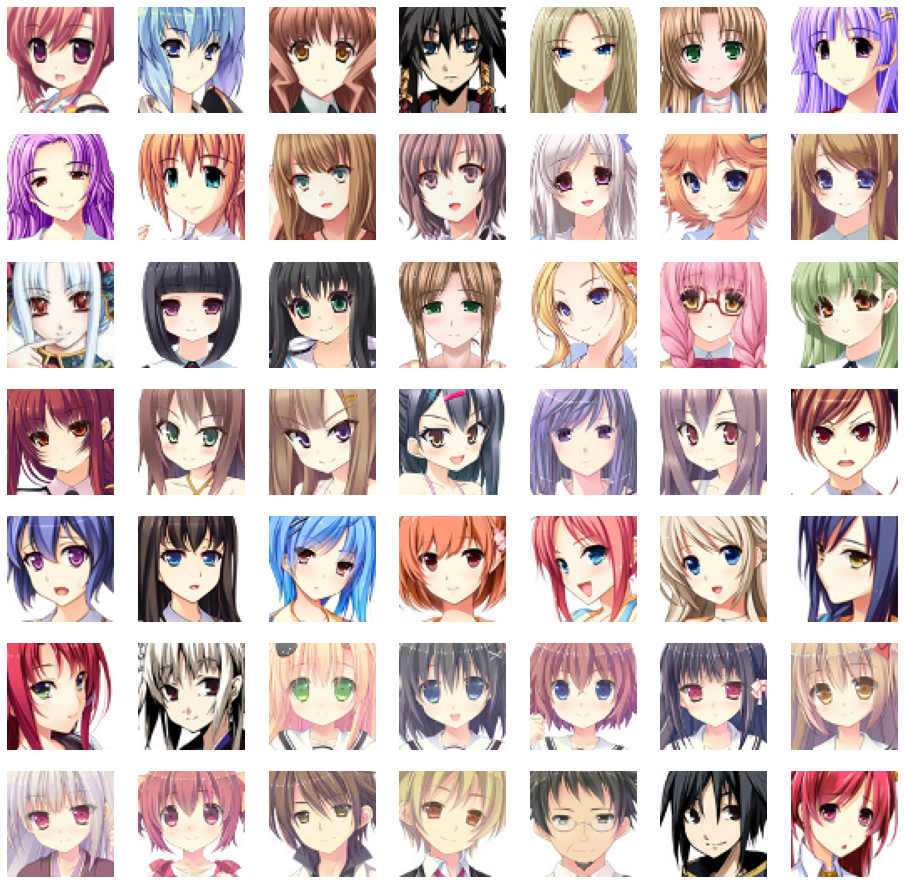

In [5]:
plt.figure(figsize=(16, 16))
temp_images = image_paths[:49]
idx = 1

for image_path in temp_images:
    plt.subplot(7, 7, idx)
    img = load_img(image_path)
    img = np.array(img)
    plt.imshow(img)
    plt.axis('off')
    idx += 1

In [6]:
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [7]:
train_images[0].shape

(64, 64, 3)

In [8]:
#reshaping the images
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

#Normalizing (-1 to 1)
train_images = (train_images - 127.5) / 127.5

In [9]:
train_images[0]

array([[[ 0.94509804,  0.42745098,  0.24705882],
        [ 0.96862745,  0.44313726,  0.33333334],
        [ 0.9529412 ,  0.5058824 ,  0.35686275],
        ...,
        [ 0.38039216, -0.38039216, -0.19215687],
        [ 0.43529412, -0.34117648, -0.15294118],
        [ 0.49019608, -0.1764706 , -0.02745098]],

       [[ 0.90588236,  0.43529412,  0.23137255],
        [ 0.92941177,  0.43529412,  0.3254902 ],
        [ 0.9529412 ,  0.44313726,  0.35686275],
        ...,
        [ 0.33333334, -0.3647059 , -0.19215687],
        [ 0.39607844, -0.37254903, -0.16862746],
        [ 0.35686275, -0.3647059 , -0.19215687]],

       [[ 0.8980392 ,  0.4117647 ,  0.2627451 ],
        [ 0.96862745,  0.4745098 ,  0.33333334],
        [ 0.75686276,  0.14509805,  0.16078432],
        ...,
        [ 0.40392157, -0.31764707, -0.12156863],
        [ 0.38039216, -0.37254903, -0.16078432],
        [ 0.35686275, -0.40392157, -0.20784314]],

       ...,

       [[ 1.        ,  1.        ,  1.        ],
        [ 1

### Modeling

In [10]:
#latent dimension for random noise
LATENT_DIM = 100
#Weight initializer
WEIGHT_INIT = keras.initializers.random_normal(mean=0.0, stddev=0.02)
#number of channels of image\
CHANNELS = 3

In [12]:
#Generator model
model = Sequential(name='generator')

#1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

#convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

#upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

#upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

#upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_1 (Dense)             (None, 32768)             3309568   
                                                                 
 re_lu_4 (ReLU)              (None, 32768)             0         
                                                                 
 reshape_1 (Reshape)         (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose_3 (Conv2DT  (None, 16, 16, 256)      2097408   
 ranspose)                                                       
                                                                 
 re_lu_5 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_4 (Conv2DT  (None, 32, 32, 128)      524416    
 ranspose)                                               

In [13]:
#Discriminator model

model = Sequential(name='descriminator')
input_shape = (64, 64, 3)
alpha = 0.2

#Downsampling image
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.4))

model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "descriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization (BatchN  (None, 32, 32, 64)       256       
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 conv2d_3 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_1 (Batc  (None, 16, 16, 128)      512       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 128)     

In [22]:
#DCGAN
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
    
    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]
    
    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn
    
    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]
        
        #generating random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))
        
        #training discriminator with real and fake images
        with tf.GradientTape() as tape:
            #compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            #generating real image labels
            real_labels = tf.ones((batch_size, 1))
            #label smoothening
            real_labels = 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)
            
            #compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            #generating fake image labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)
            
            #total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2
        
        #compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        #update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))
        
        #training generator 
        labels = tf.ones((batch_size, 1))
        
        with tf.GradientTape() as tape:
            #generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            
            #classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            #compute generator loss
            g_loss = self.loss_fn(labels, pred_fake)
        
        #compute generator gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
        
        #update states of models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        
        return {'d_loss': self.d_loss_metric.result(),
                'g_loss': self.g_loss_metric.result()}

In [23]:
class Monitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # creatimg random noise for generator
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generating images
        g_img = self.model.generator(self.noise)
        # denormalizing image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()
        
        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        plt.show()
        
    def on_train_end(self, logs=None):
        self.model.generator.save('C:\MyProjects\Image Generation\model\generator.h5')

In [24]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

D_LR = 0.0001 
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
674/674 [==============================] - ETA: 0s - d_loss: 0.4106 - g_loss: 3.8891

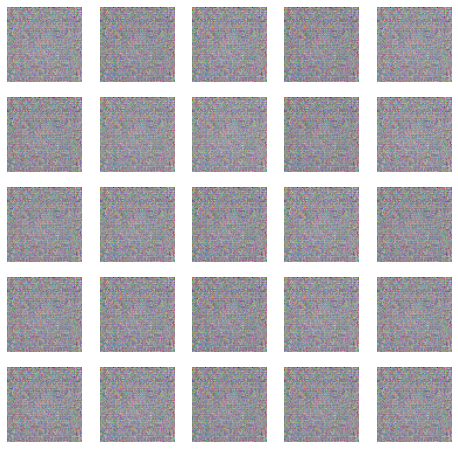

674/674 [==============================] - 757s 1s/step - d_loss: 0.4106 - g_loss: 3.8891
Epoch 2/50
674/674 [==============================] - ETA: 0s - d_loss: 0.1476 - g_loss: 4.3741

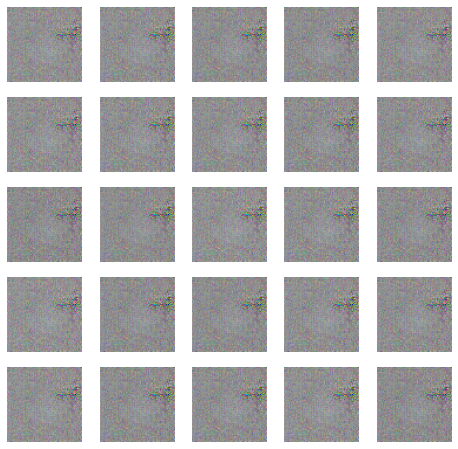

674/674 [==============================] - 891s 1s/step - d_loss: 0.1476 - g_loss: 4.3741
Epoch 3/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0905 - g_loss: 4.1654

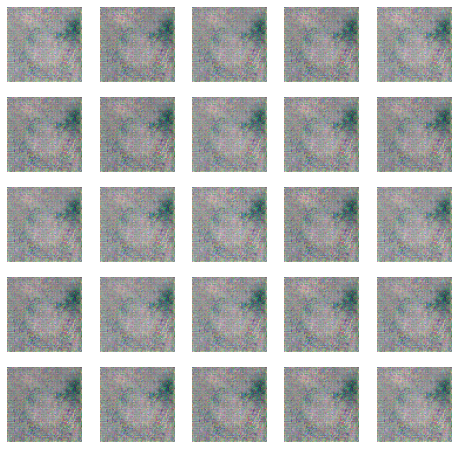

674/674 [==============================] - 1364s 2s/step - d_loss: 0.0905 - g_loss: 4.1654
Epoch 4/50
674/674 [==============================] - ETA: 0s - d_loss: 0.1031 - g_loss: 4.0060

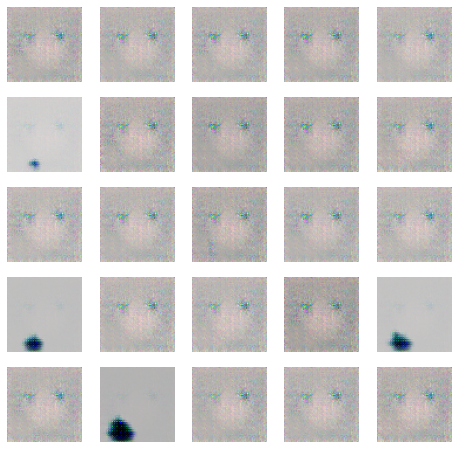

674/674 [==============================] - 1337s 2s/step - d_loss: 0.1031 - g_loss: 4.0060
Epoch 5/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0830 - g_loss: 4.0919

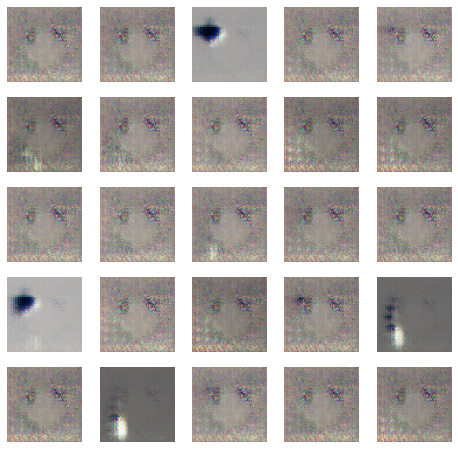

674/674 [==============================] - 1149s 2s/step - d_loss: 0.0830 - g_loss: 4.0919
Epoch 6/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0730 - g_loss: 4.6418

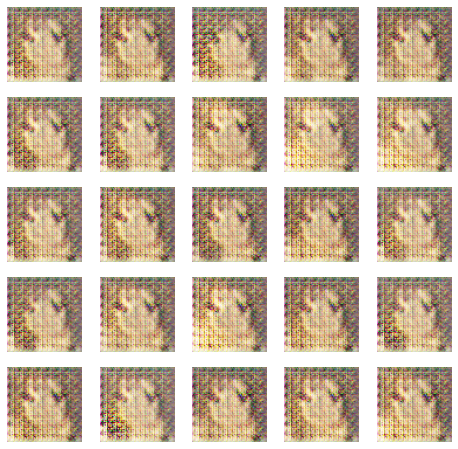

674/674 [==============================] - 1107s 2s/step - d_loss: 0.0730 - g_loss: 4.6418
Epoch 7/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0731 - g_loss: 4.3861

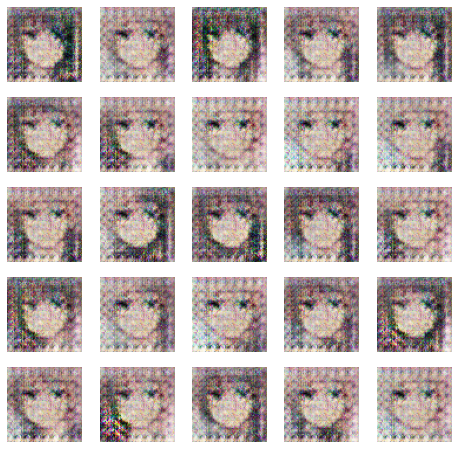

674/674 [==============================] - 1139s 2s/step - d_loss: 0.0731 - g_loss: 4.3861
Epoch 8/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0715 - g_loss: 4.3564

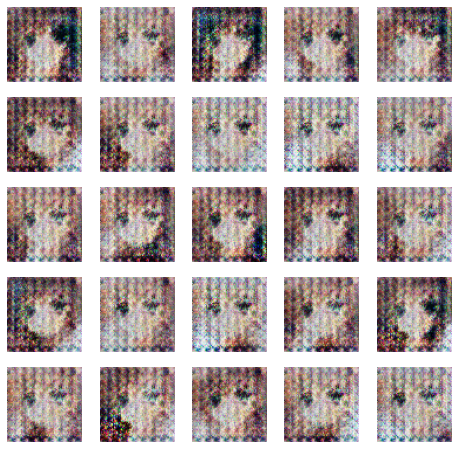

674/674 [==============================] - 1113s 2s/step - d_loss: 0.0715 - g_loss: 4.3564
Epoch 9/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0699 - g_loss: 4.4026

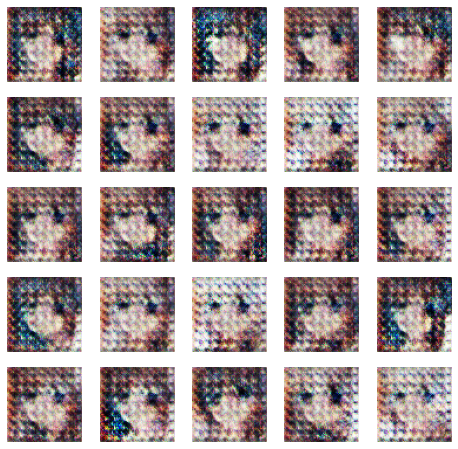

674/674 [==============================] - 1106s 2s/step - d_loss: 0.0699 - g_loss: 4.4026
Epoch 10/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0691 - g_loss: 4.4428

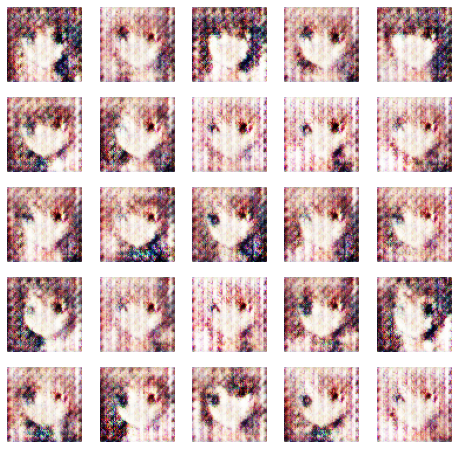

674/674 [==============================] - 1108s 2s/step - d_loss: 0.0691 - g_loss: 4.4428
Epoch 11/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0688 - g_loss: 4.4484

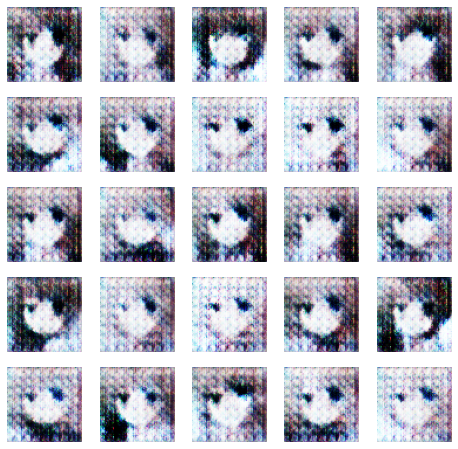

674/674 [==============================] - 1114s 2s/step - d_loss: 0.0688 - g_loss: 4.4484
Epoch 12/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0688 - g_loss: 4.4393

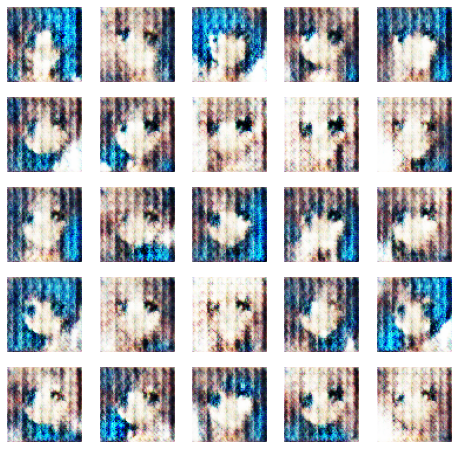

674/674 [==============================] - 1139s 2s/step - d_loss: 0.0688 - g_loss: 4.4393
Epoch 13/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0685 - g_loss: 4.4480

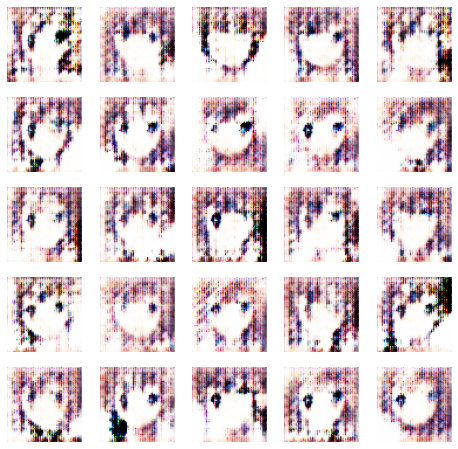

674/674 [==============================] - 1135s 2s/step - d_loss: 0.0685 - g_loss: 4.4480
Epoch 14/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0684 - g_loss: 4.4469

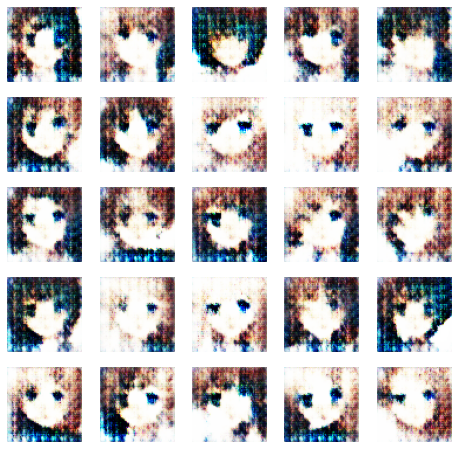

674/674 [==============================] - 889s 1s/step - d_loss: 0.0684 - g_loss: 4.4469
Epoch 15/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0682 - g_loss: 4.4420

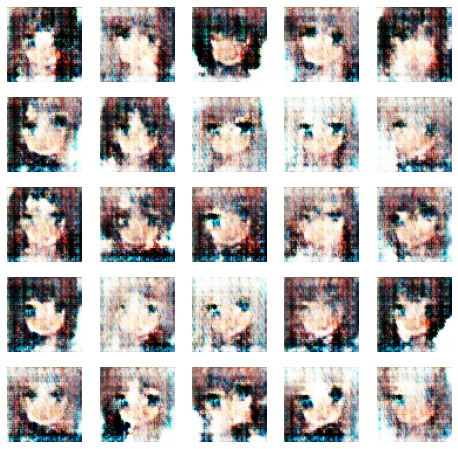

674/674 [==============================] - 772s 1s/step - d_loss: 0.0682 - g_loss: 4.4420
Epoch 16/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0679 - g_loss: 4.4557

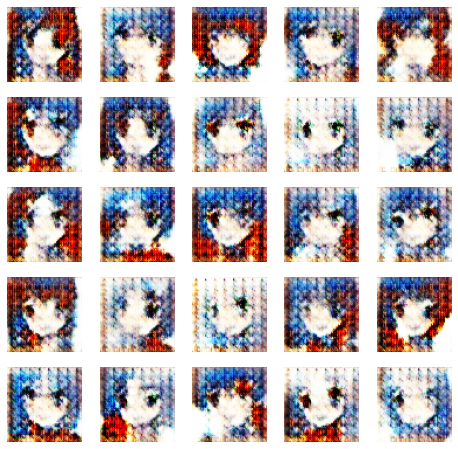

674/674 [==============================] - 771s 1s/step - d_loss: 0.0679 - g_loss: 4.4557
Epoch 17/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0682 - g_loss: 4.4419

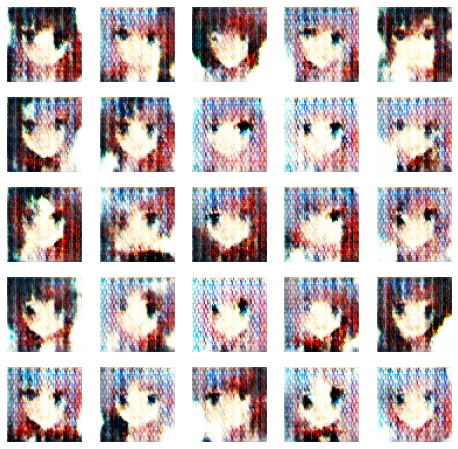

674/674 [==============================] - 770s 1s/step - d_loss: 0.0682 - g_loss: 4.4419
Epoch 18/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0681 - g_loss: 4.4393

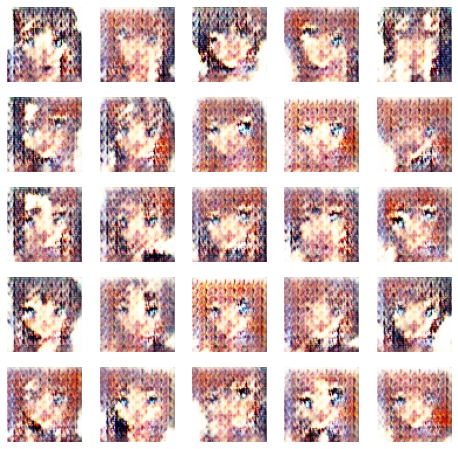

674/674 [==============================] - 771s 1s/step - d_loss: 0.0681 - g_loss: 4.4393
Epoch 19/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0680 - g_loss: 4.4394

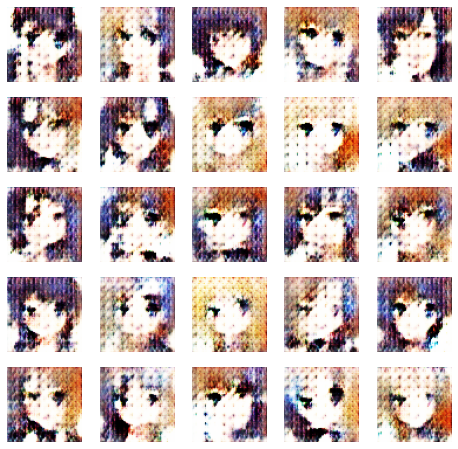

674/674 [==============================] - 768s 1s/step - d_loss: 0.0680 - g_loss: 4.4394
Epoch 20/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0678 - g_loss: 4.4412

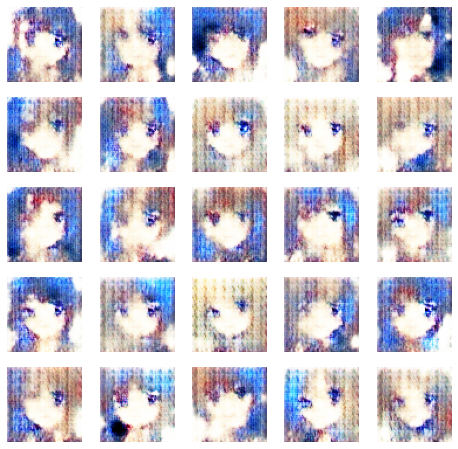

674/674 [==============================] - 768s 1s/step - d_loss: 0.0678 - g_loss: 4.4412
Epoch 21/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0678 - g_loss: 4.4470

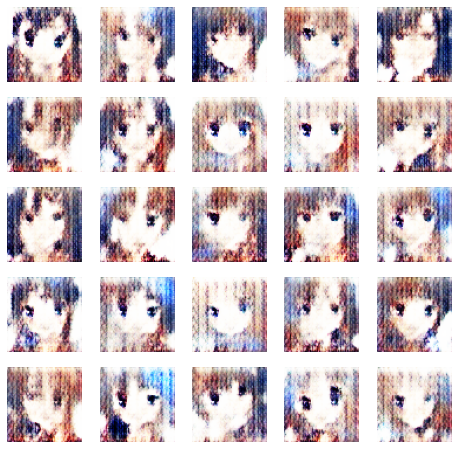

674/674 [==============================] - 770s 1s/step - d_loss: 0.0678 - g_loss: 4.4470
Epoch 22/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0678 - g_loss: 4.4482

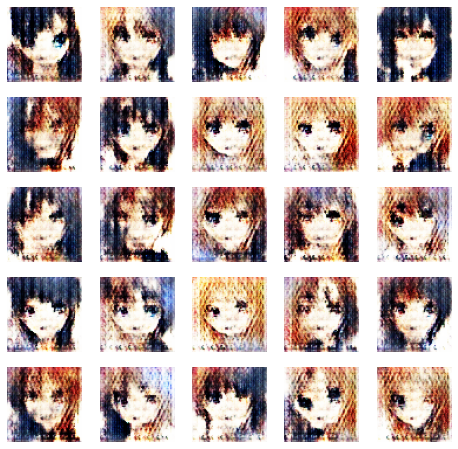

674/674 [==============================] - 785s 1s/step - d_loss: 0.0678 - g_loss: 4.4482
Epoch 23/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0678 - g_loss: 4.4434

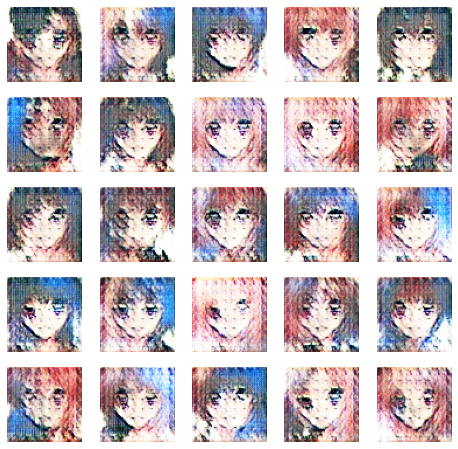

674/674 [==============================] - 770s 1s/step - d_loss: 0.0678 - g_loss: 4.4434
Epoch 24/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0676 - g_loss: 4.4423

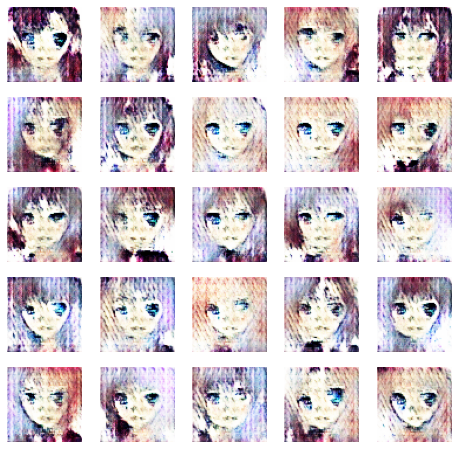

674/674 [==============================] - 763s 1s/step - d_loss: 0.0676 - g_loss: 4.4423
Epoch 25/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0675 - g_loss: 4.4512

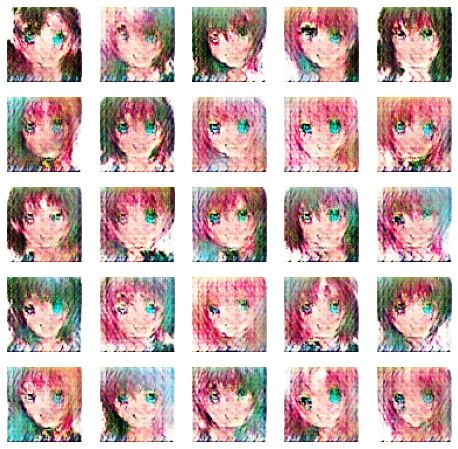

674/674 [==============================] - 759s 1s/step - d_loss: 0.0675 - g_loss: 4.4512
Epoch 26/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0677 - g_loss: 4.4566

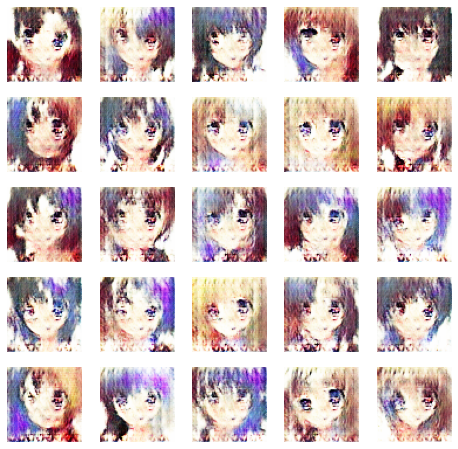

674/674 [==============================] - 759s 1s/step - d_loss: 0.0677 - g_loss: 4.4566
Epoch 27/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0678 - g_loss: 4.4761

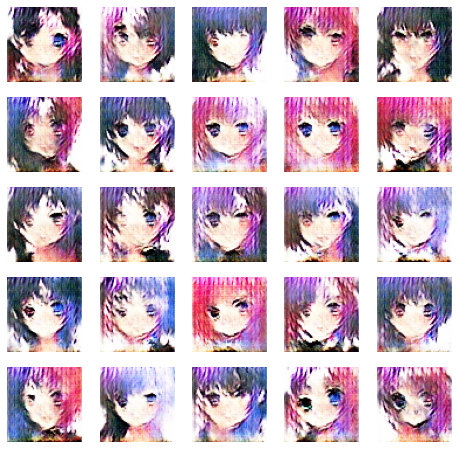

674/674 [==============================] - 760s 1s/step - d_loss: 0.0678 - g_loss: 4.4761
Epoch 28/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0676 - g_loss: 4.5021

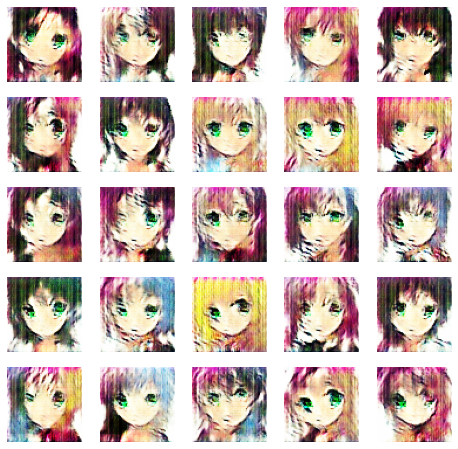

674/674 [==============================] - 761s 1s/step - d_loss: 0.0676 - g_loss: 4.5021
Epoch 29/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0677 - g_loss: 4.5599

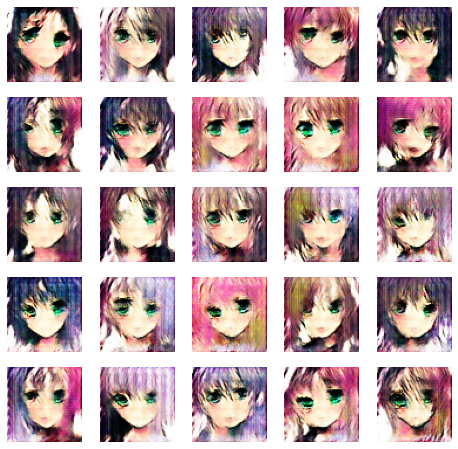

674/674 [==============================] - 759s 1s/step - d_loss: 0.0677 - g_loss: 4.5599
Epoch 30/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0671 - g_loss: 4.5611

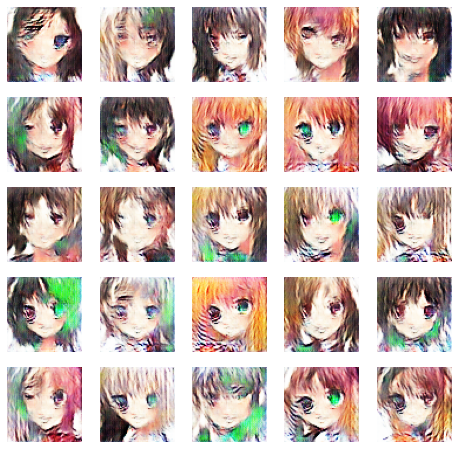

674/674 [==============================] - 761s 1s/step - d_loss: 0.0671 - g_loss: 4.5611
Epoch 31/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0674 - g_loss: 4.5309

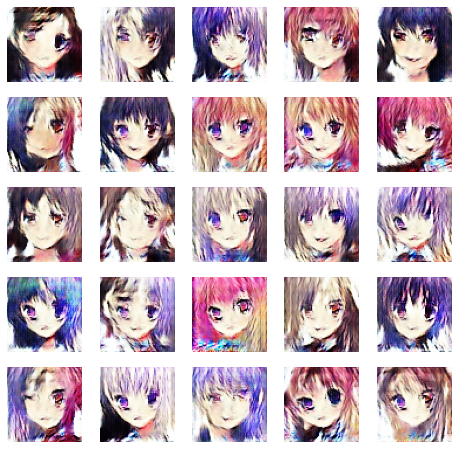

674/674 [==============================] - 760s 1s/step - d_loss: 0.0674 - g_loss: 4.5309
Epoch 32/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0675 - g_loss: 4.5154

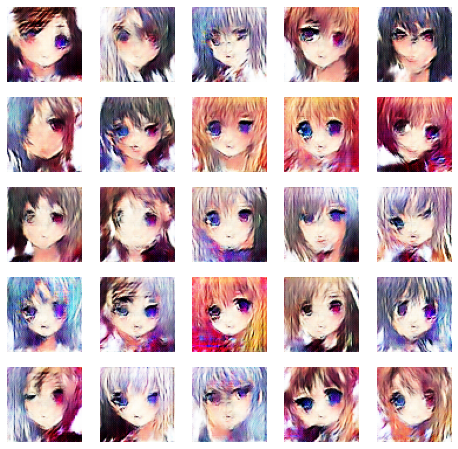

674/674 [==============================] - 763s 1s/step - d_loss: 0.0675 - g_loss: 4.5154
Epoch 33/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0673 - g_loss: 4.5102

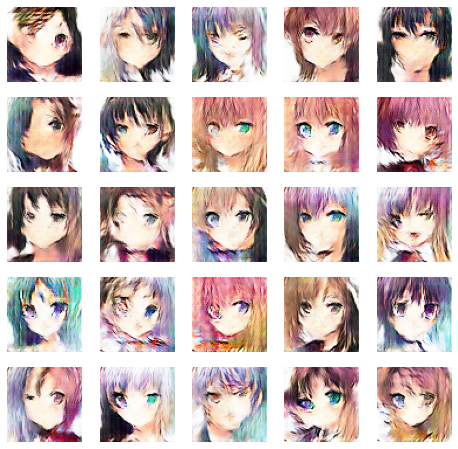

674/674 [==============================] - 763s 1s/step - d_loss: 0.0673 - g_loss: 4.5102
Epoch 34/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0671 - g_loss: 4.5113

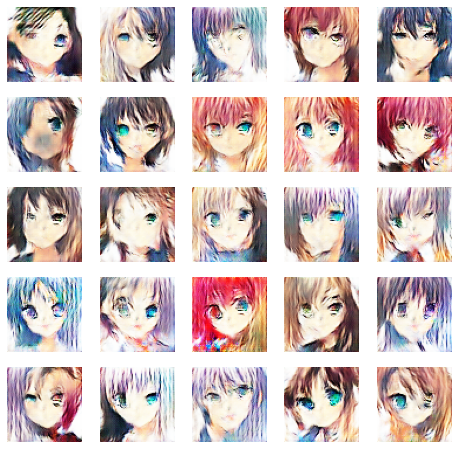

674/674 [==============================] - 762s 1s/step - d_loss: 0.0671 - g_loss: 4.5113
Epoch 35/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0675 - g_loss: 4.5004

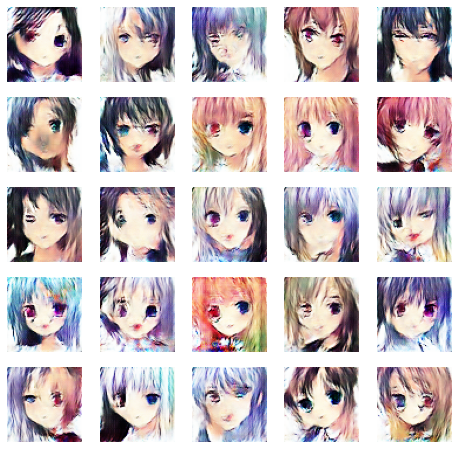

674/674 [==============================] - 762s 1s/step - d_loss: 0.0675 - g_loss: 4.5004
Epoch 36/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0673 - g_loss: 4.5025

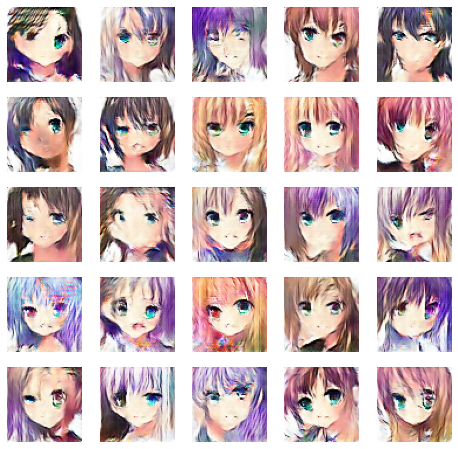

674/674 [==============================] - 760s 1s/step - d_loss: 0.0673 - g_loss: 4.5025
Epoch 37/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0671 - g_loss: 4.5114

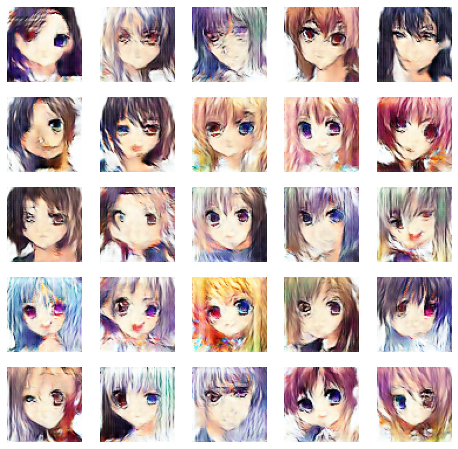

674/674 [==============================] - 762s 1s/step - d_loss: 0.0671 - g_loss: 4.5114
Epoch 38/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0676 - g_loss: 4.5093

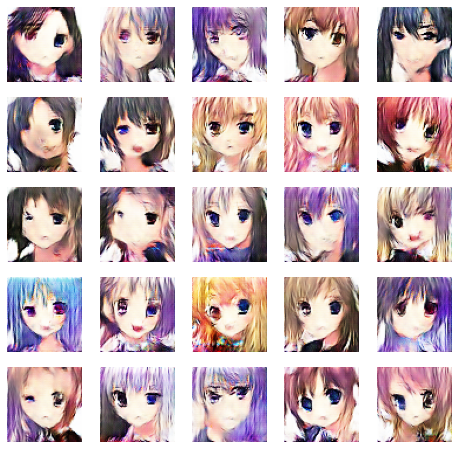

674/674 [==============================] - 762s 1s/step - d_loss: 0.0676 - g_loss: 4.5093
Epoch 39/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0673 - g_loss: 4.5144

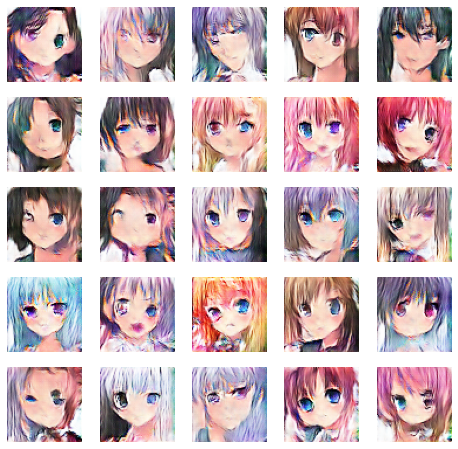

674/674 [==============================] - 763s 1s/step - d_loss: 0.0673 - g_loss: 4.5144
Epoch 40/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0673 - g_loss: 4.5104

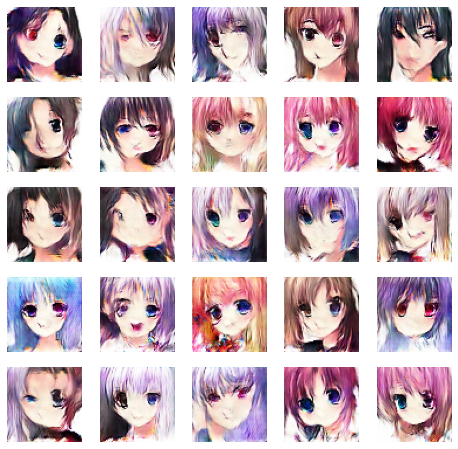

674/674 [==============================] - 764s 1s/step - d_loss: 0.0673 - g_loss: 4.5104
Epoch 41/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0671 - g_loss: 4.5118

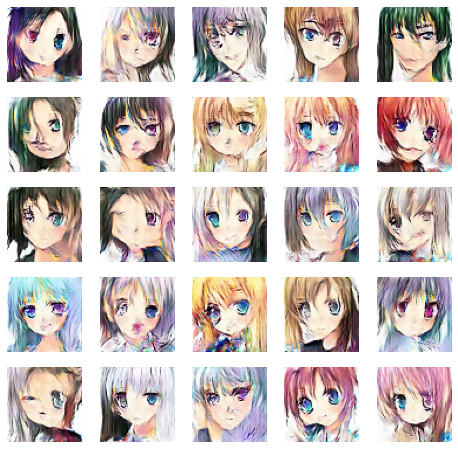

674/674 [==============================] - 768s 1s/step - d_loss: 0.0671 - g_loss: 4.5118
Epoch 42/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0672 - g_loss: 4.5113

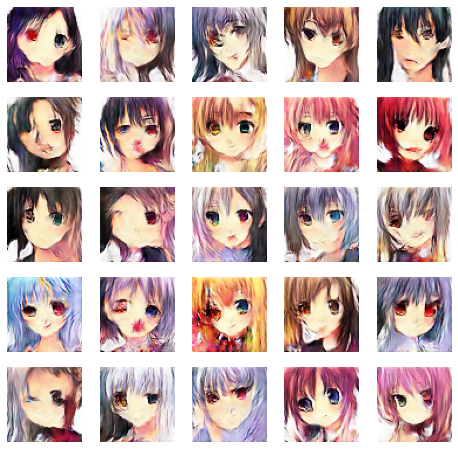

674/674 [==============================] - 765s 1s/step - d_loss: 0.0672 - g_loss: 4.5113
Epoch 43/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0668 - g_loss: 4.5196

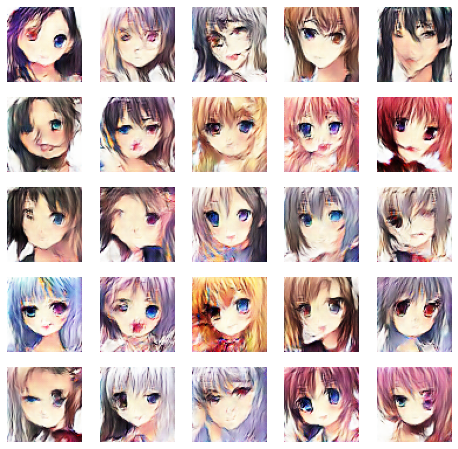

674/674 [==============================] - 762s 1s/step - d_loss: 0.0668 - g_loss: 4.5196
Epoch 44/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0671 - g_loss: 4.5091

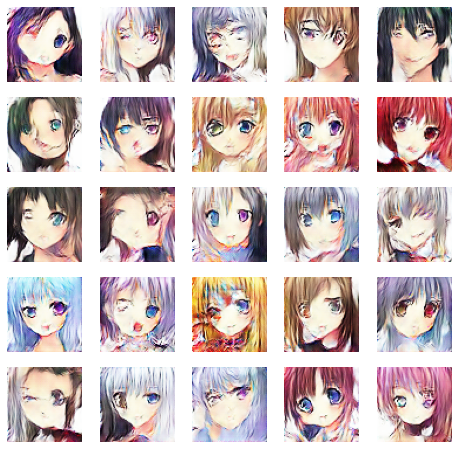

674/674 [==============================] - 765s 1s/step - d_loss: 0.0671 - g_loss: 4.5091
Epoch 45/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0670 - g_loss: 4.5135

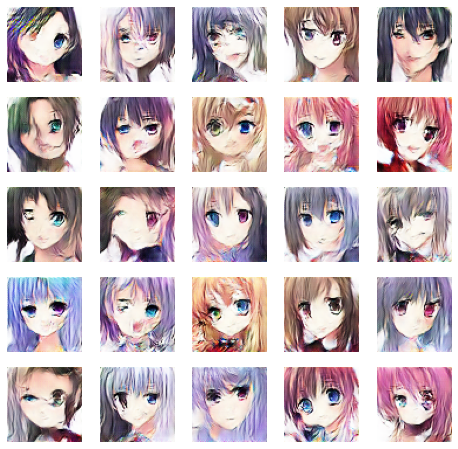

674/674 [==============================] - 763s 1s/step - d_loss: 0.0670 - g_loss: 4.5135
Epoch 46/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0674 - g_loss: 4.5054

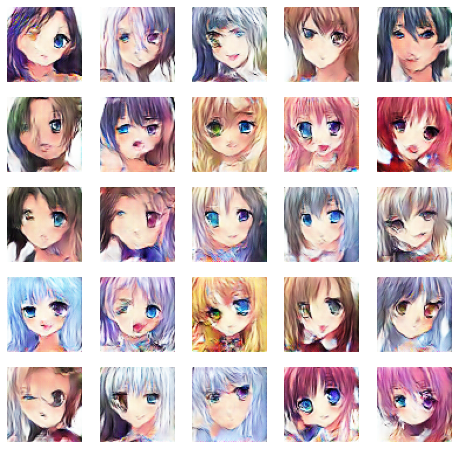

674/674 [==============================] - 768s 1s/step - d_loss: 0.0674 - g_loss: 4.5054
Epoch 47/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0675 - g_loss: 4.5034

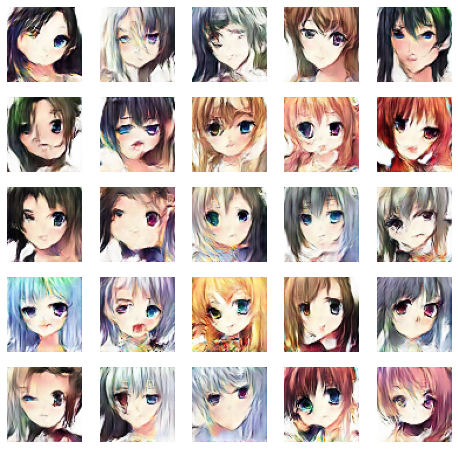

674/674 [==============================] - 769s 1s/step - d_loss: 0.0675 - g_loss: 4.5034
Epoch 48/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0672 - g_loss: 4.5072

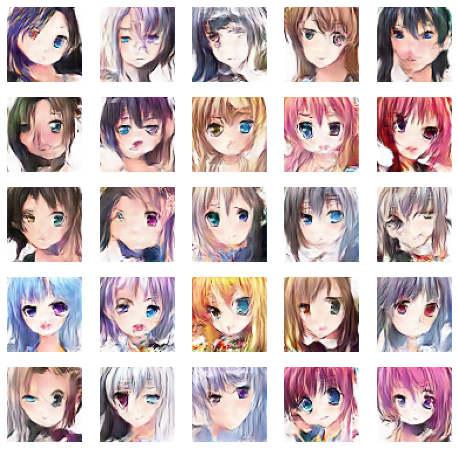

674/674 [==============================] - 762s 1s/step - d_loss: 0.0672 - g_loss: 4.5072
Epoch 49/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0675 - g_loss: 4.5063

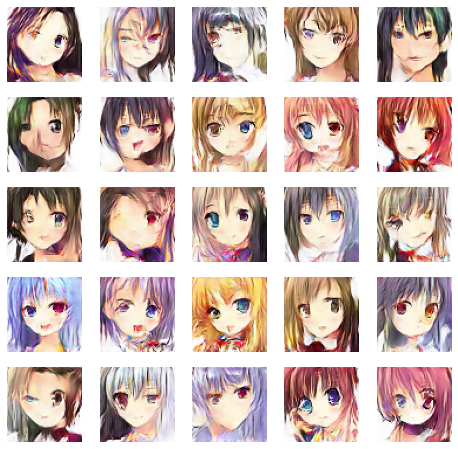

674/674 [==============================] - 767s 1s/step - d_loss: 0.0675 - g_loss: 4.5063
Epoch 50/50
674/674 [==============================] - ETA: 0s - d_loss: 0.0674 - g_loss: 4.5020

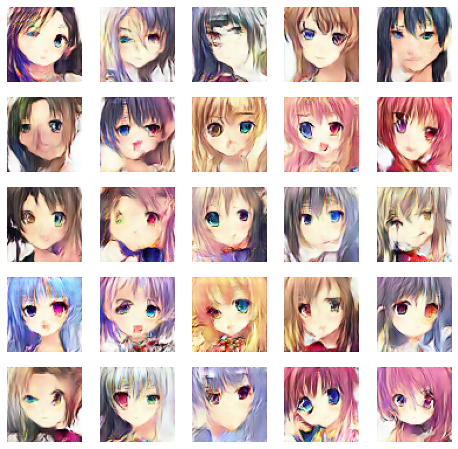

674/674 [==============================] - 766s 1s/step - d_loss: 0.0674 - g_loss: 4.5020


In [25]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[Monitor()])

### Generating new images

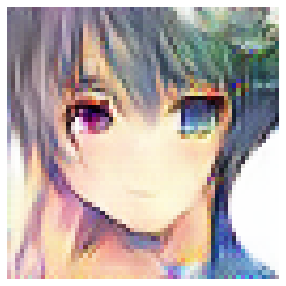

In [31]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(5, 5))

g_image = dcgan.generator(noise)

g_image = (g_image*127.5) + 127.5
g_image.numpy()
img = array_to_img(g_image[0])
plt.imshow(img)
plt.axis('off')
plt.show()